<a href="https://colab.research.google.com/github/pankajr141/experiments/blob/master/Reasoning/audio/dividing_sound_into_acoustic_components.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Below we are going to describe process to segregate sound into different acoustic component

In [36]:
import librosa
librosa.show_versions()

INSTALLED VERSIONS
------------------
python: 3.7.13 (default, Apr 24 2022, 01:04:09) 
[GCC 7.5.0]

librosa: 0.8.1

audioread: 2.1.9
numpy: 1.21.6
scipy: 1.4.1
sklearn: 1.0.2
joblib: 1.1.0
decorator: 4.4.2
soundfile: 0.10.3
resampy: 0.2.2
numba: 0.51.2

numpydoc: None
sphinx: 1.8.6
sphinx_rtd_theme: None
sphinxcontrib.versioning: None
sphinx-gallery: None
pytest: 3.6.4
pytest-mpl: None
pytest-cov: None
matplotlib: 3.2.2
presets: None


In [37]:
import librosa
filename = librosa.example('nutcracker')

In [38]:
import IPython
IPython.display.Audio(filename)

**Loading Audio file**<hr>
loads and decodes the audio as a time series (frames_wave), sampling_rate (number of samples per second of audio)<br>
By default, all audio is mixed to mono and resampled to 22050 Hz at load time. This behavior can be overridden by supplying additional

In [39]:
frames_wave, sampling_rate = librosa.load(filename)
print("frames_wave:", frames_wave.shape, "sampling_rate:", sampling_rate)

frames_wave: (2643264,) sampling_rate: 22050


**Divide timeseries into different portions**<hr>
https://www.audiolabs-erlangen.de/resources/MIR/FMP/C8/C8S1_HPS.html<br>
Musical sounds can comprise a wide range of sound components with different acoustic qualities. In particular, we consider two broad categories of sounds: harmonic sounds and percussive sounds. 
<br><br>
**harmonic** - a harmonic sound is what we perceive as pitched sound, what makes us hear melodies and chords. The prototype of a harmonic sound is the acoustic realization of a sinusoid, **which corresponds to a horizontal line in a spectrogram representation**. The sound of a violin is another typical example. most of the observed structures in the spectrogram are of horizontal nature (even though they are intermingled with noise-like components). 
<br><br>
**percussive** - is what we perceive as a clash, a knock, a clap, or a click, The sound of a drum stroke or a transient that occurs in the attack phase of a musical tone are further typical examples.  The prototype of a percussive sound is the acoustic realization of an impulse, **which corresponds to a vertical line in a spectrogram representation**.
<br><br>
This task is rather vague since it often remains unclear whether a sound event is actually of harmonic or percussive nature. Indeed, there are many sounds such as white noise or applause which are neither harmonic nor percussive.

**Basic algo**<hr>
Filter the spectogram representation in horizontal direction(along time), to enhance harmonic events and suppress percussive events, similary to get percussive signal filter spectogram in vertical direction (along frequency).<br>
The two resulting filtered spectrograms are used to generate time–frequency masks, which are then applied to the original spectrogram. From the masked spectrogram representations, the harmonic and percussive parts of the signal are obtained by applying an inverse STFT.

In [40]:
# time series frames_wave has been separated into two time series, containing the harmonic (tonal) and percussive (transient) portions of the signal. 
# Each of frames_wave_harmonic and frames_wave_percussive have the same shape and duration as frames_wave.

frames_wave_harmonic, frames_wave_percussive = librosa.effects.hpss(frames_wave)
frames_wave_harmonic.shape, frames_wave_percussive.shape

((2643264,), (2643264,))

In [41]:
IPython.display.Audio(data=frames_wave_harmonic, rate=sampling_rate)

In [42]:
IPython.display.Audio(data=frames_wave_percussive, rate=sampling_rate)

**plots our waves**

{'extent': [-0.011609977324263039, 119.87301587301587, -10.7666015625, 11035.7666015625], 'cmap': 'gray_r', 'aspect': 'auto', 'origin': 'lower', 'interpolation': 'nearest'}


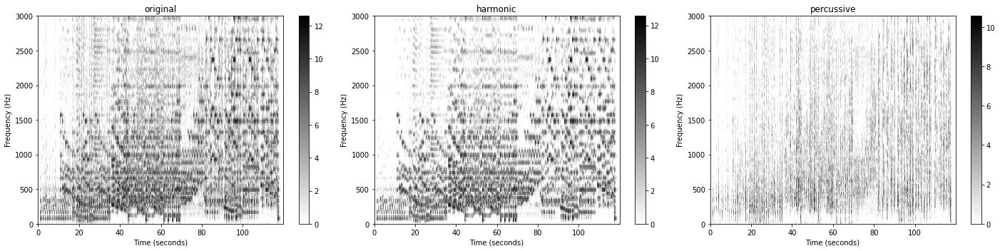

In [43]:
import numpy as np
import matplotlib.pyplot as plt

def compute_spectogram(frames, sampling_rate=22050, N=1024, H=512, log=False):
        
    # http://librosa.org/doc/main/generated/librosa.stft.html
    X = librosa.stft(frames, 
                     n_fft=N,      # Length of the windowed signal after padding with zeros, default 2048
                     hop_length=H, # number of audio samples between adjacent STFT columns.
                     win_length=N, # Each frame of audio is windowed by window of length win_length and then padded with zeros to match n_fft
                     window='hann', 
                     center=True, 
                     pad_mode='constant')
    
    Y = np.abs(X)**2
    Y_plot = Y if not log else np.log(1 + 100 * Y)
    return Y, Y_plot

def plot_spectograms(Y_plots, titles, sampling_rate=22050, N=1024, H=512, ylim=None, figsize =(5, 2)):

    # fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=72)

    Fs = sampling_rate / H
    Fs_F = N/sampling_rate

    T_coef = np.arange(Y_plots[0].shape[1]) / Fs
    F_coef = np.arange(Y_plots[0].shape[0]) / Fs_F
    x_ext1 = (T_coef[1] - T_coef[0]) / 2
    x_ext2 = (T_coef[-1] - T_coef[-2]) / 2
    y_ext1 = (F_coef[1] - F_coef[0]) / 2
    y_ext2 = (F_coef[-1] - F_coef[-2]) / 2

    kwargs = {}
    kwargs['extent'] = [T_coef[0] - x_ext1, T_coef[-1] + x_ext2, F_coef[0] - y_ext1, F_coef[-1] + y_ext2]  # Rescale the X and Y according to audio
    kwargs['cmap'] = 'gray_r'
    kwargs['aspect'] = 'auto'
    kwargs['origin'] = 'lower'
    kwargs['interpolation'] = 'nearest'

    print(kwargs)

    fig, ax = plt.subplots(1, len(Y_plots), figsize=figsize, dpi=72)

    for i, Y_plot in enumerate(Y_plots):
      im = ax[i].imshow(Y_plot, **kwargs)
      ax[i].set_xlabel('Time (seconds)')
      ax[i].set_ylabel('Frequency (Hz)')
      ax[i].set_title(titles[i])

      colorbar_aspect = 20.0
      plt.sca(ax[i])
      cbar = plt.colorbar(im, aspect=colorbar_aspect)

      if ylim is not None:
          ax[i].set_ylim(ylim)

    plt.tight_layout()
    plt.show()

_, Y_plot_harmonic = compute_spectogram(frames_wave_harmonic, sampling_rate=sampling_rate, log=1)
_, Y_plot_percussive = compute_spectogram(frames_wave_percussive, sampling_rate=sampling_rate, log=1)
_, Y_plot_original = compute_spectogram(frames_wave, sampling_rate=sampling_rate, log=1)

plot_spectograms([Y_plot_original, Y_plot_harmonic, Y_plot_percussive], 
                 titles=['original', 'harmonic', 'percussive'],  
                 ylim=[0, 3000],
                 figsize=(20, 5))

**Lets look at lots of examples**

In [44]:
import pandas as pd
import IPython.display as ipd
from collections import OrderedDict

def generate_audio_tag_html_list(waves, sampling_rate, width='150', height='40'):
    """Generates audio tag for html
    Args:
        waves (list): List of waveforms
        sampling_rate (scalar): Sample rate
    """
    audio_tag_html_list = []
    for i in range(len(waves)):
        audio_tag = ipd.Audio(waves[i], rate=sampling_rate)
        audio_tag_html = audio_tag._repr_html_().replace('\n', '').strip()
        audio_tag_html = audio_tag_html.replace('<audio ',
                                                '<audio style="width: '+width+'px; height: '+height+'px;"')
        audio_tag_html_list.append(audio_tag_html)
    return audio_tag_html_list

def display(html_original, html_harmonic, html_percussive, texts ):
    pd.options.display.float_format = '{:,.1f}'.format
    pd.set_option('display.max_colwidth', None)
    df = pd.DataFrame(OrderedDict([
        ('Example', texts),  
        ('original', html_original),
        ('harmonic', html_harmonic),
        ('percussive', html_percussive)]))
    df.index = np.arange(1, len(df) + 1)
    ipd.display(ipd.HTML(df.to_html(escape=False, index=False)))

In [45]:
examples = ['vibeace', 'brahms', 'choice']

frames_waves = []
frames_waves_harmonic = []
frames_waves_percussive = []

for example in examples:
    file_example = librosa.example(example)
    frames_wave, sampling_rate = librosa.load(file_example)
    frames_wave_harmonic, frames_wave_percussive = librosa.effects.hpss(frames_wave)

    frames_waves.append(frames_wave)
    frames_waves_harmonic.append(frames_wave_harmonic)
    frames_waves_percussive.append(frames_wave_percussive)

In [46]:
html_original = generate_audio_tag_html_list(frames_waves, sampling_rate, width='350')
html_harmonic = generate_audio_tag_html_list(frames_waves_harmonic, sampling_rate, width='350')
html_percussive = generate_audio_tag_html_list(frames_waves_percussive, sampling_rate, width='350')

display(html_original, html_harmonic, html_percussive, examples)